In [1]:
import matplotlib.pyplot as plt
import numpy as np
import random
import itertools
import matplotlib.lines as mlines
import math

import matplotlib.patches as mpatches
import matplotlib.path as mpath

import time

Path = mpath.Path

In [2]:
def isCompatible(l, lst):

    samePoint = l[0][0] == l[1][0] and l[0][1] == l[1][1]
    Existing = len(list(filter(lambda x: x[0][0] == l[0][0] and x[0][1] == l[0][1] and x[1][0] == l[1][0] and x[1][1] == l[1][1], lst))) > 0
    ReverseExisting = len(list(filter(lambda x: x[1][0] == l[0][0] and x[1][1] == l[0][1] and x[0][0] == l[1][0] and x[0][1] == l[1][1], lst))) > 0

    return not samePoint and not Existing and not ReverseExisting

In [3]:
def sharePoint(a,b):
    if (a[0][0] == b[0][0] and a[0][1] == b[0][1]) or (a[0][0] == b[0][0] and a[1][1] == b[1][1]) or (a[1][0] == b[1][0] and a[0][1] == b[0][1]) or (a[1][0] == b[1][0] and a[1][1] == b[1][1]):
        return True
    return False

In [4]:
def overlap(a,b):
    if a[1][0] - b[0][0] == 0 or a[1][0] - b[1][0] == 0:
        return True
    if a[1][0] - a[0][0] == 0:
        if not a[1][0] - b[0][0] == 0 and not a[1][0] - b[1][0] == 0:
            return False
        else:
            return True
            
    dydxa = (a[1][1] - a[0][1])/(a[1][0] - a[0][0])
    dydxa1 = (a[1][1] - b[0][1])/(a[1][0] - b[0][0])
    dydxa2 = (a[1][1] - b[1][1])/(a[1][0] - b[1][0])
    if dydxa == dydxa1 or dydxa == dydxa2:
        return True
    return False

In [5]:
def kLinesParallel(lines, k, allowlineEx):
    if k == 0:
        return True
    for lidx in range(len(lines)):
        for lidx2 in range(lidx+1, len(lines)):
            if (lines[lidx][0][0] - lines[lidx][1][0]) == 0:
                if (lines[lidx2][0][0] - lines[lidx2][1][0]) == 0:
                    if not allowlineEx:
                        if not sharePoint(lines[lidx], lines[lidx2]) and not overlap(lines[lidx], lines[lidx2]):
                            k = k - 1
                    else:
                        k = k - 1
                    if k == 0:
                        return True
                    continue
                else: 
                    continue
            elif (lines[lidx2][0][0] - lines[lidx2][1][0]) == 0:
                continue
            if (lines[lidx][0][1] - lines[lidx][1][1])/(lines[lidx][0][0] - lines[lidx][1][0]) == (lines[lidx2][0][1] - lines[lidx2][1][1])/(lines[lidx2][0][0] - lines[lidx2][1][0]):
                if not allowlineEx:
                    if not sharePoint(lines[lidx], lines[lidx2]) and not overlap(lines[lidx], lines[lidx2]):
                        k = k - 1
                else:
                    k = k - 1
    if k == 0:
        return True
    return False

In [6]:
def minPunktDistance(points, minDistance):
    for i in range(len(points)):
        for j in range(i+1,len(points)):
            if math.sqrt((points[i][0]-points[j][0])*(points[i][0]-points[j][0])+(points[i][1]-points[j][1])*(points[i][1]-points[j][1])) < minDistance:
                return False
    return True

In [7]:
def minOutlierDistance(points, nOutlier, minOutlierDistance):
    if nOutlier == 0:
        return True
    xCoords = []
    yCoords = []
    for i in range(len(points)):
       xCoords.append(points[i][0])
       yCoords.append(points[i][1])
    meanX = np.mean(xCoords)
    meanY = np.mean(yCoords)
    meanPoint = (meanX, meanY)
    
    for i in range(len(points)):
        if math.sqrt((points[i][0]-meanPoint[0])*(points[i][0]-meanPoint[0])+(points[i][1]-meanPoint[1])*(points[i][1]-meanPoint[1])) > minOutlierDistance:
            nOutlier = nOutlier -1
            if nOutlier == 0:
                return True
    return False 

In [8]:
maxPerLoop = 20_000

In [109]:
def createDataSet(fvector1, fvector2, setSize, writeOutput, heightFactor, widthFactor):
    if (writeOutput):
        timestr = time.strftime("%Y%m%d-%H%M%S")
        with open(""+timestr+"_output-Run10.txt", 'a') as file:
            file.write("imgName \t xValue \t yValue \t convexCoords \t concaveCoords \n")
            file.close
    for didx in range(setSize):
        featureVector = (
            0 ,# Points
            0 ,# Lines
            0, # Lines parallel
            0, # min point distance
            0, # lines rounded convex
            0, # lines rounded concave
            0, # convex magnitued
            0, # concave magnitued
            False, # parallel Line Extensions Allowed
            0, # Outlier distance
            0, # Outliers
            "lightgray", # Line Color
            "lightgray", # Fill Color
            "lightgray", # Point Color
            False, # Show Points
        )
        if didx < setSize/2:
            featureVector = fvector1
        if didx >= setSize/2:
            featureVector = fvector2
        
        fig, ax = plt.subplots()
        fig.set_size_inches(7, 7)
        statusOK = False
        
        # default value of the height to width ratio
        hToW_ratio = "none"

        itt0 = 0

        while not statusOK:
            if itt0 > maxPerLoop:
                print("Max failure")
                break
            statusOK = True
            x = []
            y = []
            for pt in range(featureVector[0]):
                x.append(random.randint(round(-80*widthFactor),round(80*widthFactor))) 
                y.append(random.randint(round(-80*heightFactor),round(80*heightFactor))) 
            
            if not minPunktDistance(list(zip(x,y)), featureVector[3]):
                statusOK = False
                continue
            if not minOutlierDistance(list(zip(x,y)),featureVector[11],featureVector[10]):
                statusOK = False
                continue
            lines = []
            whiteLines = []
            lineComp = []

            linesToRoundConvex = featureVector[4]
            linesToRoundConcave = featureVector[5]

            roundLinesConvex = []
            roundLinesConcave = []
            centroid = [np.array(x).mean(), np.array(y).mean()]
            xExtremes = [np.array(x).min(), np.array(x).max()]
            yExtremes = [np.array(y).min(), np.array(y).max()]
            lineCount = featureVector[1]
            if featureVector[9]:
                featureVectorCp = list(featureVector)
                featureVectorCp[1] = featureVectorCp[1] - (featureVectorCp[0]+1)
                lineCount = featureVectorCp[1]
                if featureVectorCp[1] < 0:
                    print("Too less lines")
                    return
                
                # to be calculated

                lowerBound = max(linesToRoundConvex -lineCount, 0)
                upperBound = min(linesToRoundConvex , (featureVectorCp[0]+1))

                convexConnectingLines = 0

                if lowerBound == upperBound:
                    convexConnectingLines = lowerBound
                elif lowerBound > upperBound:
                    print("Error on linecounts")
                else:
                    convexConnectingLines = random.randint(lowerBound, upperBound)

                lowerBound = max(linesToRoundConcave -lineCount-convexConnectingLines, 0)
                upperBound = min(linesToRoundConcave , (featureVectorCp[0]+1-convexConnectingLines))
                                                           
                concaveConnectingLines = 0

                if lowerBound == upperBound:
                    concaveConnectingLines = lowerBound
                elif lowerBound > upperBound:
                    print("Error on linecounts")
                else:
                    concaveConnectingLines = random.randint(lowerBound, upperBound)

                lastPoint = list(zip(x,y))[-1]

                for point in list(zip(x,y)):
                    line = (lastPoint, point)
                    if convexConnectingLines > 0:
                        thirdPointx = line[0][0] + (line[1][0]-line[0][0])/2
                        thirdPointy = line[0][1] + (line[1][1]-line[0][1])/2
                        vectorMag = math.sqrt((centroid[0]-thirdPointx)*(centroid[0]-thirdPointx)+(centroid[1]-thirdPointy)*(centroid[1]-thirdPointy))/featureVector[6]
                        roundLinesConvex.append([line[0], [int(thirdPointx-(centroid[0]-thirdPointx)/vectorMag),int(thirdPointy-(centroid[1]-thirdPointy)/vectorMag)] ,line[1]])
                        linesToRoundConvex = linesToRoundConvex - 1
                        convexConnectingLines = convexConnectingLines - 1
                        lineComp.append(line)
                    elif concaveConnectingLines > 0:
                        thirdPointx = line[0][0] + (line[1][0]-line[0][0])/2
                        thirdPointy = line[0][1] + (line[1][1]-line[0][1])/2
                        vectorMag = math.sqrt((centroid[0]-thirdPointx)*(centroid[0]-thirdPointx)+(centroid[1]-thirdPointy)*(centroid[1]-thirdPointy))/featureVector[7]
                        roundLinesConcave.append([line[0], [int(thirdPointx+(centroid[0]-thirdPointx)/vectorMag),int(thirdPointy+(centroid[1]-thirdPointy)/vectorMag)] ,line[1]])
                        linesToRoundConcave = linesToRoundConcave - 1
                        concaveConnectingLines = concaveConnectingLines - 1
                        whiteLines.append(line)
                        lineComp.append(line)
                    else:
                        lineComp.append(line)
                        lines.append(line)
                    lastPoint = point
                    

            for lncnt in range(lineCount):
                line = random.choice(list(itertools.product(list(zip(x,y)), list(zip(x,y)))))
                itt1 = 0
                while not isCompatible(line, lineComp):
                    itt1 = itt1 + 1
                    line = random.choice(list(itertools.product(list(zip(x,y)), list(zip(x,y)))))
                    if itt1 > maxPerLoop:
                        statusOK = False
                        break
                if linesToRoundConvex > 0:
                    thirdPointx = line[0][0] + (line[1][0]-line[0][0])/2
                    thirdPointy = line[0][1] + (line[1][1]-line[0][1])/2
                    vectorMag = math.sqrt((centroid[0]-thirdPointx)*(centroid[0]-thirdPointx)+(centroid[1]-thirdPointy)*(centroid[1]-thirdPointy))/featureVector[6]
                    roundLinesConvex.append([line[0], [int(thirdPointx-(centroid[0]-thirdPointx)/vectorMag),int(thirdPointy-(centroid[1]-thirdPointy)/vectorMag)] ,line[1]])
                    linesToRoundConvex = linesToRoundConvex - 1
                    lineComp.append(line)
                elif linesToRoundConcave > 0:
                    thirdPointx = line[0][0] + (line[1][0]-line[0][0])/2
                    thirdPointy = line[0][1] + (line[1][1]-line[0][1])/2
                    vectorMag = math.sqrt((centroid[0]-thirdPointx)*(centroid[0]-thirdPointx)+(centroid[1]-thirdPointy)*(centroid[1]-thirdPointy))/featureVector[7]
                    roundLinesConcave.append([line[0], [int(thirdPointx+(centroid[0]-thirdPointx)/vectorMag),int(thirdPointy+(centroid[1]-thirdPointy)/vectorMag)] ,line[1]])
                    linesToRoundConcave = linesToRoundConcave - 1
                   

                    lineComp.append(line)
                else:
                    lineComp.append(line)
                    lines.append(line)
            if not kLinesParallel(lines, featureVector[2], featureVector[8]):
                statusOK = False
            itt0 = itt0 + 1
        if statusOK:
            print("Ok")
            for oneLine in lines:
                pointOne = oneLine[0]
                pointTwo = oneLine[1]
                l = mlines.Line2D([pointOne[0],pointTwo[0]], [pointOne[1],pointTwo[1]], color=featureVector[12])
                ax.add_line(l)
            ax.fill(x,y, color=featureVector[13], edgecolor = "none", linewidth = 0.0)
            for roundLine in roundLinesConvex:
                # Debug Mode
                #pp1 = mpatches.PathPatch(Path([roundLine[0], roundLine[1], roundLine[2]],[Path.MOVETO, Path.CURVE3, Path.CURVE3]),fc=featureVector[13], fill=True, color="yellow", transform=ax.transData)
                pp1 = mpatches.PathPatch(Path([roundLine[0], roundLine[1], roundLine[2]],[Path.MOVETO, Path.CURVE3, Path.CURVE3]),fc=featureVector[13], fill=True, color=featureVector[12], transform=ax.transData)
                ax.add_patch(pp1)
            for roundLine in roundLinesConcave:
                # Debug Mode
                #pp1 = mpatches.PathPatch(Path([roundLine[0], roundLine[1], roundLine[2]],[Path.MOVETO, Path.CURVE3, Path.CURVE3]),fc=featureVector[13], fill=True, color="green", transform=ax.transData)
                pp1 = mpatches.PathPatch(Path([roundLine[0], roundLine[1], roundLine[2]],[Path.MOVETO, Path.CURVE3, Path.CURVE3]),fc="none", fill=True, color=featureVector[12], transform=ax.transData)
                ax.add_patch(pp1)
            
            #ax.scatter(centroid[0], centroid[1], color="red")
            #ax.scatter(x, y, color=featureVector[14])
        else:
            didx = didx - 1
            print("Status not ok")
            print("Max run ?")
            
        hToW_maxFactor = max(widthFactor,heightFactor)
        ax.set(xlim=(centroid[0]-(80*1.25*hToW_maxFactor), centroid[0]+(80*1.25*hToW_maxFactor)),
               xticks=np.arange(centroid[0]-(80*1.25*hToW_maxFactor), centroid[0]+(80*1.25*hToW_maxFactor), step = 25), 
            ylim=(centroid[1]-(80*1.25*hToW_maxFactor), centroid[1]+(80*1.25*hToW_maxFactor)), 
            yticks=np.arange(centroid[1]-(80*1.25*hToW_maxFactor), centroid[1]+(80*1.25*hToW_maxFactor), step = 25)) 
        plt.gca().set_aspect("equal")
        fig.set_facecolor('#ffffff')

        plt.axis('off')
        #plt.show() # comment out to save plot
        
        if featureVector[4]>0:
            xExtremePlusConvexCandidates = xExtremes
            yExtremePlusConvexCandidates = yExtremes
            xExtremePlusConvexCandidates.append(np.array(roundLinesConvex)[0][1][0])
            yExtremePlusConvexCandidates.append(np.array(roundLinesConvex)[0][1][1])
            xExtremesPlusConvex = [np.array(xExtremePlusConvexCandidates).min(), np.array(xExtremePlusConvexCandidates).max()]
            yExtremesPlusConvex = [np.array(yExtremePlusConvexCandidates).min(), np.array(yExtremePlusConvexCandidates).max()]

            xMaxDiff = xExtremesPlusConvex[1]-xExtremesPlusConvex[0]
            yMaxDiff = yExtremesPlusConvex[1]-yExtremesPlusConvex[0]
        else:
            # create x and y distance for heigth to width ratio
            xMaxDiff = xExtremes[1]-xExtremes[0]
            yMaxDiff = yExtremes[1]-yExtremes[0]
     
        if (xMaxDiff>=(2*yMaxDiff)):
            hToW_ratio = "veryClearlyWider"
        elif (xMaxDiff>=(1.5*yMaxDiff)):
            hToW_ratio = "clearlyWider"
        elif (xMaxDiff>=(1.05*yMaxDiff)):
            hToW_ratio = "wider"
        elif (xMaxDiff>=(1.01*yMaxDiff)):
            hToW_ratio = "unclearlyWider"
        elif (xMaxDiff<=(0.25*yMaxDiff)):
            hToW_ratio = "veryClearlyHigher"
        elif (xMaxDiff<=(0.5*yMaxDiff)):
            hToW_ratio = "clearlyHigher"    
        elif (xMaxDiff<=(0.95*yMaxDiff)):
            hToW_ratio = "higher"
        elif (xMaxDiff<=(0.99*yMaxDiff)):
            hToW_ratio = "unclearlyHigher"
        else:
            hToW_ratio = "borderline" 

        filename = "run10"+featureVector[15]+"_"+hToW_ratio+""
        plt.savefig("plots/"+hToW_ratio+"/"+filename+"_"+str(didx)+".png", dpi = 100, bbox_inches = 'tight') # comment in to save plot
        if (writeOutput):
            with open(""+timestr+"_output-Run10.txt", 'a') as file: # if changed here, change above necessary
                for valueX, valueY in zip(x, y):
                    file.write("" +filename+"_"+str(didx)+".png \t" )
                    file.write("" + str(valueX) + "\t")
                    file.write("" + str(valueY) + "\t")
                    # logging concave, convex coords
                    file.write("" + str(roundLinesConvex) + "\t")
                    file.write("" + str(roundLinesConcave) + "\n")

Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok


C:\Users\Admin\AppData\Local\Temp\ipykernel_5828\854793323.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
Ok
O

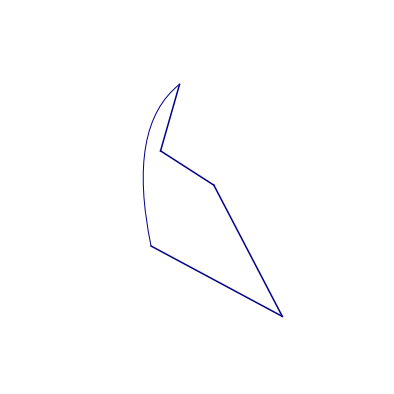

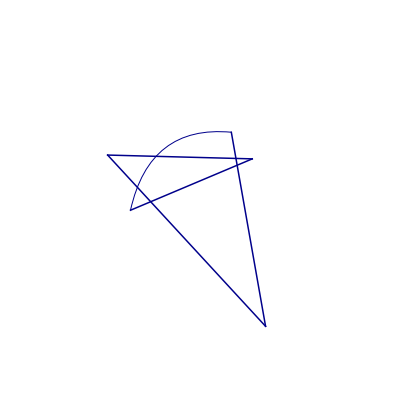

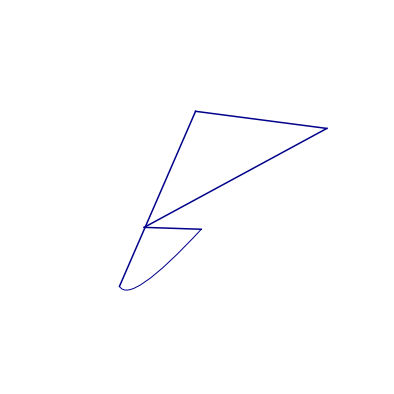

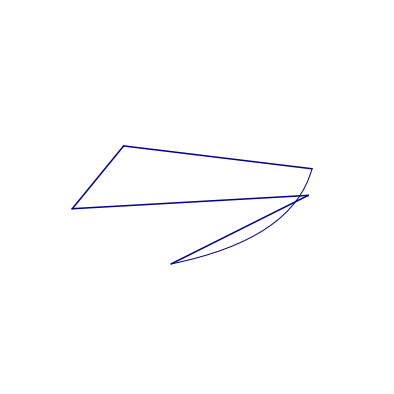

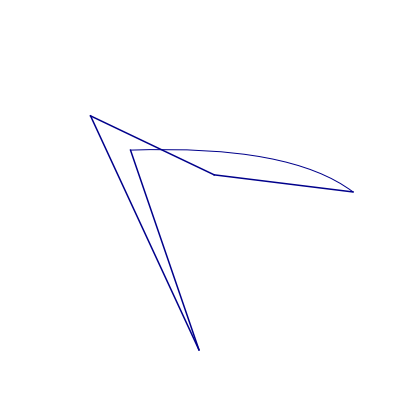

...

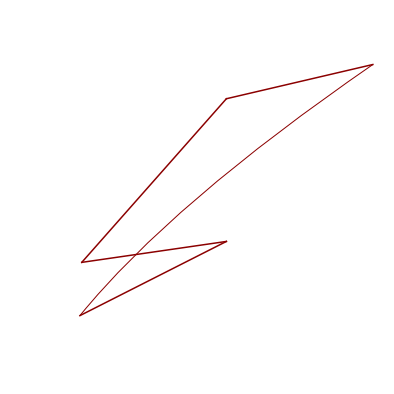

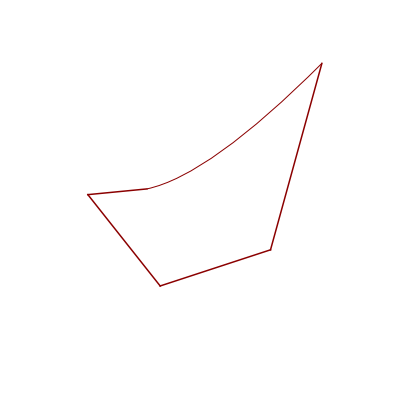

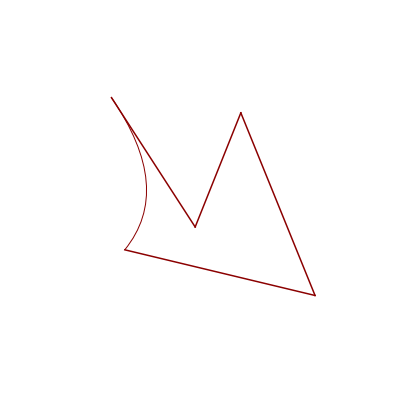

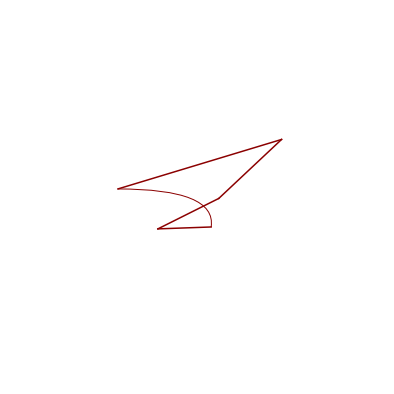

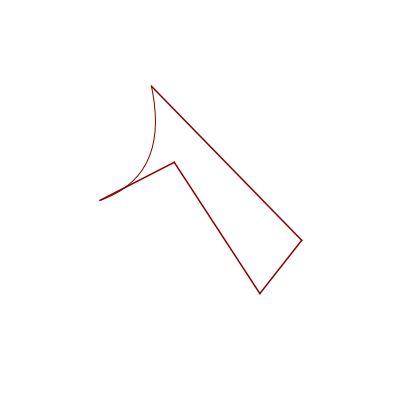

In [110]:
featureVectorBlueConvex = (
            5 ,# Points
            6 ,# Lines
            0, # Lines parallel
            10, # min point distance
            1, # lines rounded convex
            0, # lines rounded concave
            30, # convex magnitued
            30, # concave magnitued
            False, # parallel Line Extensions Allowed
            True, # All points connected
            10, # Outlier Distance
            1, # Outlier
            "darkblue", # Color
            "none", # Fill Color
            "blue", # Point Color
            "BlueConvex", # label featureVector
        )
featureVectorBlueConcave = (
            5 ,# Points
            6 ,# Lines
            0, # Lines parallel
            10, # min point distance
            0, # lines rounded convex
            1, # lines rounded concave
            30, # convex magnitued
            30, # concave magnitued
            False, # parallel Line Extensions Allowed
            True, # All points connected
            10, # Outlier Distance
            1, # Outlier
            "darkblue", # Line Color
            "none", # Fill Color
            "blue", # Point Color
            "BlueConcave", # label featureVectore
        )

featureVectorRedConvex = (
            5 ,# Points
            6 ,# Lines
            0, # Lines parallel
            10, # min point distance
            1, # lines rounded convex
            0, # lines rounded concave
            30, # convex magnitued
            30, # concave magnitued
            False, # parallel Line Extensions Allowed
            True, # All points connected
            10, # Outlier distance
            1, # Outlier
            "darkred", # Color
            "none", # Fill Color
            "red", # Point Color
            "RedConvex", # label featureVectore
        )
featureVectorRedConcave = (
            5 ,# Points
            6 ,# Lines
            0, # Lines parallel
            10, # min punkt distance
            0, # lines rounded convex
            1, # lines rounded concave
            30, # convex magnitued
            30, # concave magnitued
            False, # parallel Line Extensions Allowed
            True, # All points connected
            10, # Outlier distance
            1, # Outlier
            "darkred", # Line Color
            "none", # Fill Color
            "red", # Point Color
            "RedConcave", # label featureVectore
        )

  
createDataSet(featureVectorBlueConvex, featureVectorRedConcave, 2, True, 1, 1)
#createDataSet(featureVectorRedConvex, featureVectorBlueConcave, 20, False, 1, 1)